In [1]:
import warnings
warnings.filterwarnings('ignore')

import os
import ast
import json
import time
import math
import numpy as np
import pandas as pd
import seaborn as sns
from matplotlib import cm
import matplotlib.pyplot as plt
from tqdm import tqdm_notebook as tqdm
from sklearn.preprocessing import MinMaxScaler

from TSB_UAD.models.distance import Fourier
from TSB_UAD.models.feature import Window

from TSB_UAD.models.cnn import cnn
from TSB_UAD.models.pca import PCA
from TSB_UAD.models.lof import LOF
from TSB_UAD.models.lstm import lstm
from TSB_UAD.models.poly import POLY
from TSB_UAD.models.ocsvm import OCSVM
from TSB_UAD.models.norma import NORMA
from TSB_UAD.models.iforest import IForest
from TSB_UAD.models.AE_mlp2 import AE_MLP2
from TSB_UAD.models.matrix_profile import MatrixProfile

from TSB_UAD.utils.metrics import metricor
from TSB_UAD.utils.slidingWindows import find_length,plotFig


from IPython.core.display import display, HTML
display(HTML("<style>.container { width:95% !important; }</style>"))

# 0. Set path to benchmark data

We first load the benchmark and the accuracy tables (for each accuracy measures)

In [8]:
# You have to download first the benchmark. Please look at the README.md for instructions
BENCHMARK_PATH = '../../data/benchmark/'
ALL_TABLE_PATH = ['../accuracy_table/'+f for f in os.listdir('../accuracy_table/')]

# I. Visualize benchmark time series Example

We first extract all the files names and the datasets names, we then plot one example per dataset.
Briefly, the benchmark includes the following datasets:

* __Dodgers__: This dataset is a loop sensor data for the Glendale on-ramp for the 101 North freeway in Los Angeles and the anomalies represent unusual traffic after a Dodgers game.
* __ECG__:  It is a standard electrocardiogram dataset and the anomalies represent ventricular premature contractions. 
* __IOPS__: This is a dataset with performance indicators that reflect the scale, quality of web services, and health status of a machine.
* __KDD21__: This dataset is a composite dataset released in a recent SIGKDD 2021 competition.
* __MGAB__: This is composed of Mackey-Glass time series with non-trivial anomalies. Mackey-Glass time series exhibit chaotic behavior that is difficult for the human eye to distinguish.
* __NAB__: It is composed of labeled real-world and artificial time series including AWS server metrics, online advertisement clicking rates, real time traffic data, and a collection of Twitter mentions of large publicly-traded companies.
* __NASA-SMAP and NASA-MSL__: These dataset are two real spacecraft telemetry data with anomalies from Soil Moisture Active Passive (SMAP) satellite and Curiosity Rover on Mars (MSL). We only keep the first data dimension that presents the continuous data, and we omit the remaining dimensions with binary data. 
* __SensorScope__: This is a collection of environmental data, such as temperature, humidity, and solar radiation, collected from a typical tiered sensor measurement system.
* __Yahoo__: It is a dataset published by Yahoo labs consisting of real and synthetic time series based on the real production traffic to some of the Yahoo production systems.
* __Daphnet__: This contains the annotated readings of 3 acceleration sensors at the hip and leg of Parkinson's disease patients that experience freezing of gait (FoG) during walking tasks.
* __GHL__: It is a Gasoil Heating Loop Dataset and contains the status of 3 reservoirs such as the temperature and level. Anomalies indicate changes in max temperature or pump frequency.
* __Genesis__: This is a portable pick-and-place demonstrator which uses an air tank to supply all the gripping and storage units.
* __MITDB__: This dataset contains 48 half-hour excerpts of two-channel ambulatory ECG recordings, obtained from 47 subjects studied by the BIH Arrhythmia Laboratory between 1975 and 1979.
* __OPPORTUNITY (OPP)__: It is a dataset devised to benchmark human activity recognition algorithms (e.g., classification, automatic data segmentation, sensor fusion, and feature extraction). The dataset comprises the readings of motion sensors recorded while users executed typical daily activities.
* __Occupancy__: This contains experimental data used for binary classification (room occupancy) from temperature, humidity, light, and CO2. Ground-truth occupancy was obtained from time stamped pictures that were taken every minute.
* __SMD__: It is a 5-week-long dataset collected from a large Internet company. This dataset contains 3 groups of entities from 28 different machines.
* __SVDB__: This dataset includes half-hour ECG recordings chosen to supplement the examples of supraventricular arrhythmias in the MIT-BIH Arrhythmia Database.


In [3]:
def get_label(filepath):
    df = pd.read_csv(filepath, header=None)
    return df

all_files = {}
for folder in  os.listdir(BENCHMARK_PATH):
    if '.D' not in folder: #ignore .DS_Store in MACOS system
        all_files[folder] = []
        for file_s in os.listdir('{}{}/'.format(BENCHMARK_PATH,folder)):
            if '.D' not in file_s: #ignore .DS_Store in MACOS system
                if 'train' not in file_s:
                    all_files[folder].append('{}{}/{}'.format(BENCHMARK_PATH,folder,file_s))
                

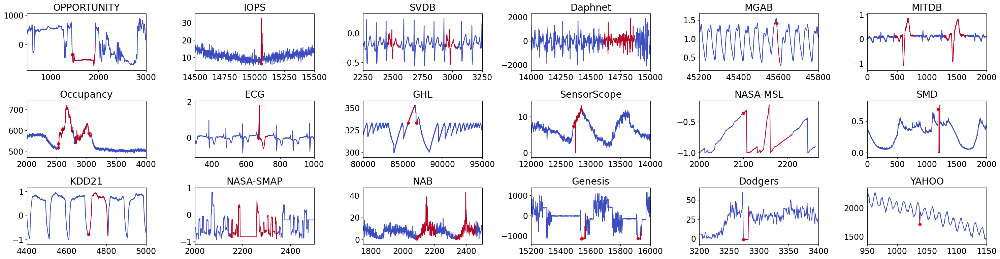

In [4]:
import matplotlib

plt.rcParams.update({'font.size': 17})

id_ts = {
    'OPPORTUNITY': 4, 'IOPS': 1, 
    'SVDB': 1, 'Daphnet': 8, 'MGAB': 0, 'MITDB': 2, 'Occupancy': 3, 'ECG': 7, 
    'GHL': 24, 'SensorScope': 15, 'NASA-MSL': 0, 'SMD': 0, 'KDD21': 112, 
    'NASA-SMAP': 4, 'NAB': 5, 'Genesis': 0, 'Dodgers': 0, 'YAHOO': 0
}


id_range = {
    'OPPORTUNITY': [500,3000], 'IOPS': [14500,15500], 'SVDB': [2250,3250], 
    'Daphnet': [14000,15000], 'MGAB': [45200,45800], 'MITDB': [0,2000], 
    'Occupancy': [2000,4000], 'ECG': [300,1000], 'GHL': [80000,95000], 
    'SensorScope': [12000,14000], 'NASA-MSL': [2000,2270], 'SMD': [0,2000], 
    'KDD21': [4400,5000], 'NASA-SMAP': [2000,2500], 'NAB': [1750,2500], 
    'Genesis': [15200,16000], 'Dodgers': [3200,3400], 'YAHOO': [950,1150]
}

colors = ['black','red']


def plot_colourline(x,y,c):
    c = cm.coolwarm((c-np.min(c))/(np.max(c)-np.min(c)))
    ax = plt.gca()
    for i in np.arange(len(x)-1):
        ax.plot([x[i],x[i+1]], [y[i],y[i+1]], c=c[i])
    return

plt.figure(figsize=(30,8))

for i,folder in enumerate(all_files.keys()):
    plt.subplot(3,6,i+1)
    data = get_label(all_files[folder][id_ts[folder]])
    data = data[id_range[folder][0]:id_range[folder][1]]
    previous = 0
    edges_x,edges_y = [],[]
    for ind,val,lab in zip(data.index,data[0].values,data[1].values):
        if ((lab == 1) and (previous == 0)):
            edges_x.append(ind)
            edges_y.append(val)
        previous = lab
            
    plot_colourline(data.index,data[0].values,data[1].values)
    plt.scatter(edges_x,edges_y,color='red')
    plt.title(folder)
    if id_range[folder] is not None:
        plt.xlim(id_range[folder][0],id_range[folder][1])
        plt.ylim(min(data[0].values) - abs(max(data[0].values)-min(data[0].values))*0.1,max(data[0].values) + abs(max(data[0].values)-min(data[0].values))*0.1)
        
plt.tight_layout()

# II. Extraction of Accuracy values and Meta data

We now import the desired accuracy table. For this we provide several accuracy measures that we describe below.

### Threshold-based AD Evaluation Measures

The anomaly score $S_T$ produced by an AD method $A$ highlights the
parts of the time series $T$ considered as abnormal. The highest values
in the anomaly score correspond to the most abnormal points.
Threshold-based measures require to set a threshold to mark each point
as an anomaly or not. Usually, this threshold is set to
$\mu(S_T) + \alpha*\sigma(S_T)$, with $\alpha$ set to
3, where $\mu(S_T)$ is the mean and $\sigma(S_T)$
is the standard deviation $S_T$. Given a threshold $Thres$, we compute
the $pred \in \{0,1\}^n$ as follows:


$\forall i \in [1,|S_T|],$

$pred_i = 0, \text{if: } {S_T}_i < Thres $

$pred_i = 1, \text{if: } {S_T}_i \geq Thres $


Threshold-based measures compare $pred$ to $label \in \{0,1\}^n$, which
indicates the true (human provided) labeled anomalies. Given the
Identity vector $I=[1,1,...,1]$, the points detected as anomalies or not
fall into the following four categories:

-   **True Positive (TP)**: Number of points that have been correctly
    identified as anomalies. Formally: $TP = label^\top \cdot pred$.

-   **True Negative (TN)**: Number of points that have been correctly
    identified as normal. Formally: $TN = (I-label)^\top \cdot (I-pred)$.

-   **False Positive (FP)**: Number of points that have been wrongly
    identified as anomalies. Formally: $FP = (I-label)^\top \cdot pred$.

-   **False Negative (FN)**: Number of points that have been wrongly
    identified as normal. Formally: $FN = label^\top \cdot (I-pred)$.

Given these four categories, several quality measures have been proposed
to assess the accuracy of AD methods. 

* **Precision:** We define Precision (or positive predictive value) as the number correctly identified anomalies over the total number of points detected as anomalies by the method: $Precision = \frac{TP}{TP+FP}$

* **Recall:** We define Recall (or True Positive Rate (TPR), $tpr$) as the number of correctly identified anomalies over all anomalies: $Recall = \frac{TP}{TP+FN}$

* **False Positive Rate (FPR):** A supplemental measure to the Recall is the FPR, $fpr$, defined as the number of points wrongly identified as anomalies over the total number of normal points: $fpr = \frac{FP}{FP+TN}$

* **F-Score:** Precision and Recall evaluate two different aspects of the AD quality. A measure that combines these two aspects is the harmonic mean $F_{\beta}$, with non-negative real values for $\beta$: $F_{\beta} = \frac{(1+\beta^2)*Precision*Recall}{\beta^2*Precision+Recall}$ Usually, $\beta$ is set to 1, balancing the importance between Precision and Recall.

* **Precision@k:** All previous measures require an anomaly score threshold to be computed. An alternative approach is to measure the Precision using a subset of anomalies corresponding to the $k$ highest value in the anomaly score $S_T$. This is equivalent to setting the threshold such that only the $k$ highest values are retrieved.


To address the shortcomings of the point-based quality measures, a
range-based definition was recently proposed, extending the mathematical
models of the traditional Precision and Recall.
This definition considers several factors: (i) whether a subsequence is
detected or not (ExistenceReward or ER); (ii) how many points in the
subsequence are detected (OverlapReward or OR); (iii) which part of the
subsequence is detected (position-dependent weight function); and (iv)
how many fragmented regions correspond to one real subsequence outlier
(CardinalityFactor or CF). Formally, we define $R=\{R_1,...R_{N_r}\}$ as
the set of anomaly ranges, with
$R_k=\{pos_i,pos_{i+1}, ..., pos_{i+j}\}$ and
$\forall pos \in R_k, label_{pos} = 1$, and $P=\{P_1,...P_{N_p}\}$ as
the set of predicted anomaly ranges, with
$P_k=\{pos_i,pos_{i+1}, ..., pos_{i+j}\}$ and
$\forall pos \in R_k, pred_{pos} = 1$. Then, we define ER, OR, and CF as
follows:

* $ER(R_i,P)$ is defined as follows:

 $ER(R_i,P) = 1, \text{if } \sum_{j=1}^{N_p} |R_i \cap P_j| \geq 1$

 $ER(R_i,P) = 0, \text{otherwise}$

* $CF(R_i,P)$ is defined as follows:

 $CF(R_i,P) = 1, \text{if } \exists P_i \in P, |R_i \cap P_i| \geq 1$

 $CF(R_i,P) = \gamma(R_i,P), \text{otherwise}$

* $OR(R_i,P)$ is defined as follows:

 $OR(R_i,P) = CF(R_i,P)*\sum_{j=1}^{N_p} \omega(R_i,R_i \cap P_j, \delta)$


The $\gamma(),\omega()$, and $\delta()$ are tunable functions that
capture the cardinality, size, and position of the overlap respectively.
The default parameters are set to $\gamma()=1,\delta()=1$ and $\omega()$
to the overlap ratio covered by the predicted anomaly
range. 

* **Rprecision:** Based on the above, we define:


 $Rprecision(R,P) = \frac{\sum_{i=1}^{N_p} Rprecision_s(R,P_i)}{N_p}$

 $Rprecision_s(R,P_i) = CF(P_i,R)*\sum_{j=1}^{N_r} \omega(P_i,P_i \cap R_j, \delta)$

* **Rrecall:** Based on the above, we define:

 $Rrecall(R,P) = \frac{\sum_{i=1}^{N_r} Rrecall_s(R_i,P)}{N_r}$

 $Rrecall_s(R_i,P) = \alpha*ER(R_i,P) + (1-\alpha)*OR(R_i,P)$


 The parameter $\alpha$ is user defined. The default value is $\alpha=0$. 

* **R-F-score (RF):** As described previously, the F-score combines Precision and Recall. Similarly, we define $RF_{\beta}$, with non-negative real values for $\beta$ as follows:

 $RF_{\beta} = \frac{(1+\beta^2)*Rprecision*Rrecall}{\beta^2*Rprecision+Rrecall}$

 As before, $\beta$ is set to 1. In this demo, $RF_1$ is referred to as RF-score.

***

### Threshold-independent AD Evaluation Measures


* **AUC-ROC:** The Area Under the Receiver Operating Characteristics curve (AUC-ROC) is defined as the area under the curve corresponding to TPR on the y-axis and FPR on the x-axis when we vary the anomaly score threshold. The area under the curve is computed using the trapezoidal rule. For that purpose, we define $Th$ as an ordered set of thresholds between 0 and 1. Formally, we have $Th=[Th_0,Th_1,...Th_N]$ with $0=Th_0<Th_1<...<Th_N=1$. Therefore, $AUC\text{-}ROC$ is defined as follows: 

 $AUC\text{-}ROC = \frac{1}{2}\sum_{k=1}^{N} \Delta^{k}_{TPR}*\Delta^{k}_{FPR}$

 with:

 $\Delta^{k}_{FPR} = FPR(Th_{k})-FPR(Th_{k-1})$

 $\Delta^{k}_{TPR} = TPR(Th_{k-1})+TPR(Th_{k})$

* **AUC-PR:** The Area Under the Precision-Recall curve (AUC-PR) is defined as the area under the curve corresponding to the Recall on the x-axis and Precision on the y-axis when we vary the anomaly score threshold. As before, the area under the curve is computed using the trapezoidal rule. Thus, we define AUC-PR: 

 $AUC\text{-}PR = \frac{1}{2}\sum_{k=1}^{N} \Delta^{k}_{Precision}*\Delta^{k}_{Recall}$

 with:

 $\Delta^{k}_{Recall} = Recall(Th_{k})-Recall(Th_{k-1})$

 $\Delta^{k}_{Precision} = Precision(Th_{k-1})+Precision(Th_{k})$


A simpler alternative to approximate the area underthe curve is to compute the average Precision of the PR curve: In this demo, we use the above equation to approximate AUC-PR. 
 
## Summary

In total we provide 9 accuracy measures and we providethe accuracy results for each of these measures in 9 tables listed below:

In [14]:
for i,f in enumerate(ALL_TABLE_PATH): print("{}: {} --> ({})".format(i,f.split('_')[-1].split('.')[0],f))

0: RF --> (../accuracy_table/mergedTable_RF.csv)
1: Rrecall --> (../accuracy_table/mergedTable_Rrecall.csv)
2: Precision --> (../accuracy_table/mergedTable_Precision.csv)
3: ROC --> (../accuracy_table/mergedTable_AUC_ROC.csv)
4: F --> (../accuracy_table/mergedTable_F.csv)
5: Recall --> (../accuracy_table/mergedTable_Recall.csv)
6: Precision@k --> (../accuracy_table/mergedTable_Precision@k.csv)
7: Rprecision --> (../accuracy_table/mergedTable_Rprecision.csv)
8: PR --> (../accuracy_table/mergedTable_AUC_PR.csv)


## Accuracy Table

In [15]:
df_acc = pd.read_csv(ALL_TABLE_PATH[3]) #We use AUC-ROC is this demo
df_acc

,filename,IFOREST,LOF,MP,NORMA,IFOREST1,HBOS,OCSVM,PCA,AE,...,ratio,nb_anomaly,average_anom_length,median_anom_length,std_anom_length,data_len,point_anom,seq_anom,mixed_anom,type_an
0,101-freeway-traffic.test.out,0.789245,0.528458,0.523189,0.780872,0.561967,0.296598,0.641820,0.775967,0.658808,...,0.111349,133,42.195489,33.0,60.990750,50400,0,0,1,mixed
1,MBA_ECG801_data.out,0.807440,0.481875,0.514667,0.813916,0.587447,0.805644,0.357021,0.815331,0.220826,...,0.126700,345,83.695652,75.0,81.351893,227900,0,1,0,sequence
2,MBA_ECG803_data.out,0.974167,0.469958,0.389757,0.997130,0.734172,0.980218,0.890454,0.963986,0.931447,...,0.047852,147,75.000000,75.0,0.000000,230400,0,1,0,sequence
3,MBA_ECG805_data.out,0.930408,0.462080,0.244094,0.974199,0.721249,0.893629,0.704588,0.936441,0.857042,...,0.087674,208,97.115385,101.0,19.976336,230400,0,1,0,sequence
4,MBA_ECG806_data.out,0.535588,0.783037,0.914707,0.987386,0.542097,0.349671,0.775272,0.457216,0.859422,...,0.022630,61,85.475410,75.0,47.240094,230400,0,1,0,sequence
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1882,871.test.csv@2.out,0.699513,0.743512,0.766917,0.897322,0.561485,0.683663,0.601986,0.701246,0.723122,...,0.015352,23,153.782609,154.0,19.112838,230400,0,1,0,sequence
1883,864.test.csv@2.out,0.796461,0.640020,0.823401,0.976276,0.621895,0.720707,0.534953,0.654697,0.791972,...,0.069887,81,198.790123,147.0,119.245645,230400,0,1,0,sequence
1884,852.test.csv@2.out,0.561958,0.613171,0.837606,0.885803,0.540519,0.553256,0.444877,0.532333,0.749150,...,0.148598,300,114.123333,110.0,24.712644,230400,0,1,0,sequence
1885,826.test.csv@1.out,0.567314,0.744960,0.810351,0.942276,0.528829,0.576366,0.706781,0.565981,0.851989,...,0.034423,72,110.152778,104.0,41.080767,230400,0,1,0,sequence


# III. Global Experimental Visualisation

In this section, we visualize the accuracy results of each methods on each time series. We use the AUC-ROC accuracy measure.

## III.1. Pairwise Comparisons of Methods

One scatter blue point is a time series

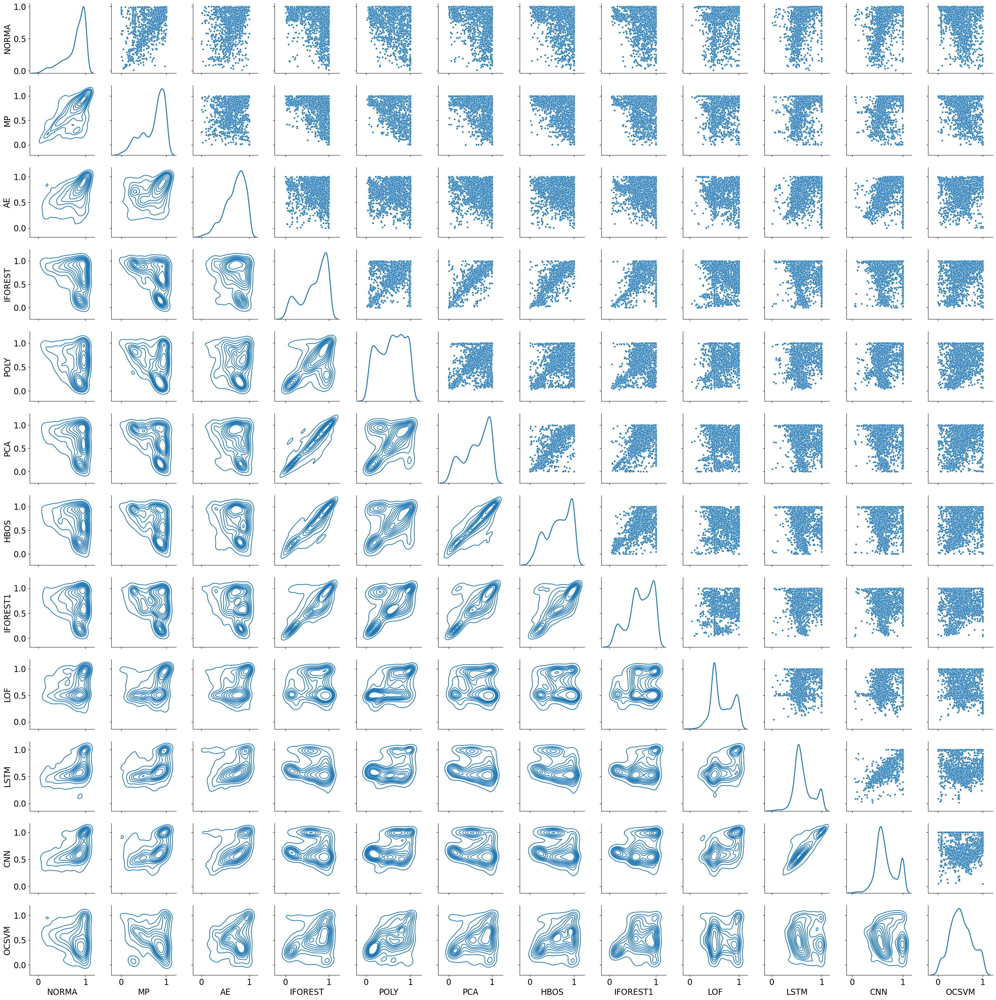

In [17]:
methods_all = ['NORMA','MP','AE','IFOREST','POLY','PCA','HBOS','IFOREST1','LOF','LSTM','CNN','OCSVM']

g = sns.PairGrid(df_acc[methods_all],diag_sharey=False)
g.map_upper(sns.scatterplot, s=15)
g.map_lower(sns.kdeplot)
g.map_diag(sns.kdeplot, lw=2)

## III.2. Pairwise Comparisons of Methods: Point  vs subsequence

In green: time series containing only point anomalies.
In organge: time series containing only sequence anomalies.
In blue: time series containing both point and sequence anomalies.

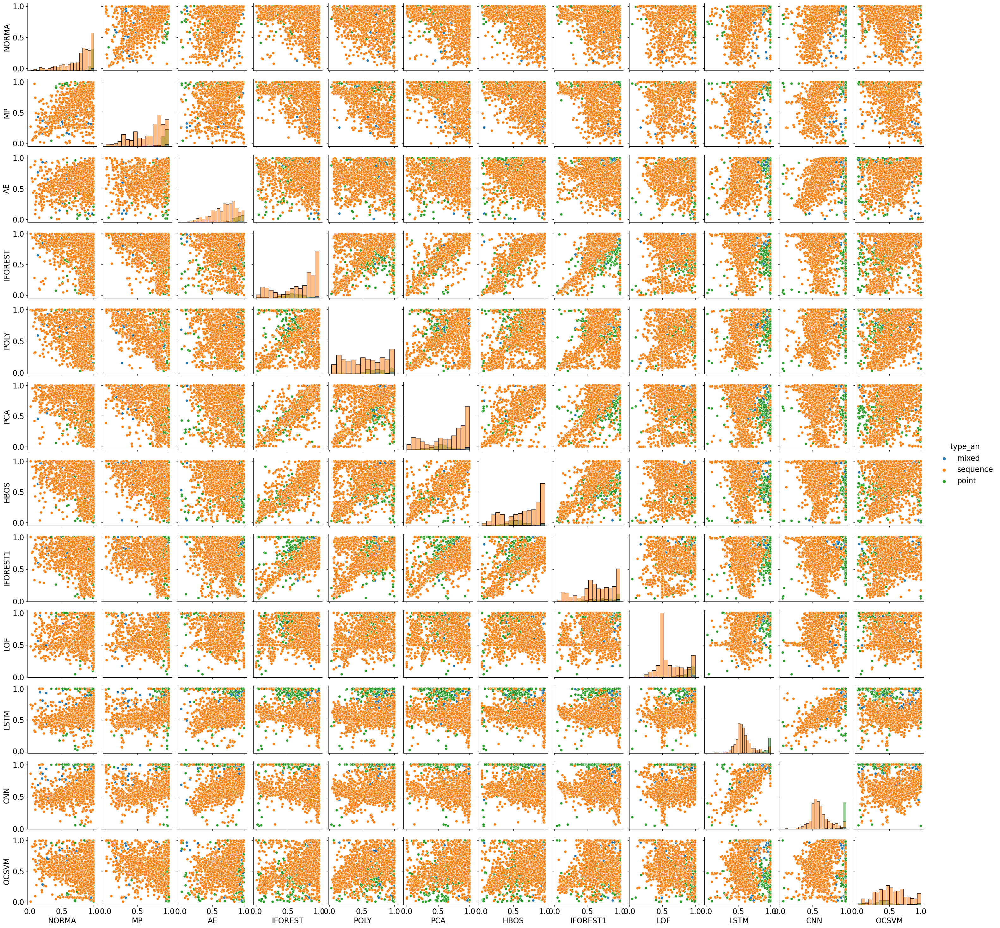

In [18]:
sns.pairplot(df_acc[methods_all + ['type_an']], hue="type_an",diag_kind='hist')

## III.3. Pairwise Comparisons of Methods: Single  vs Multiple anomalies

In organge: time series containing multiple anomalies.
In blue: time series containing only one anomaly.

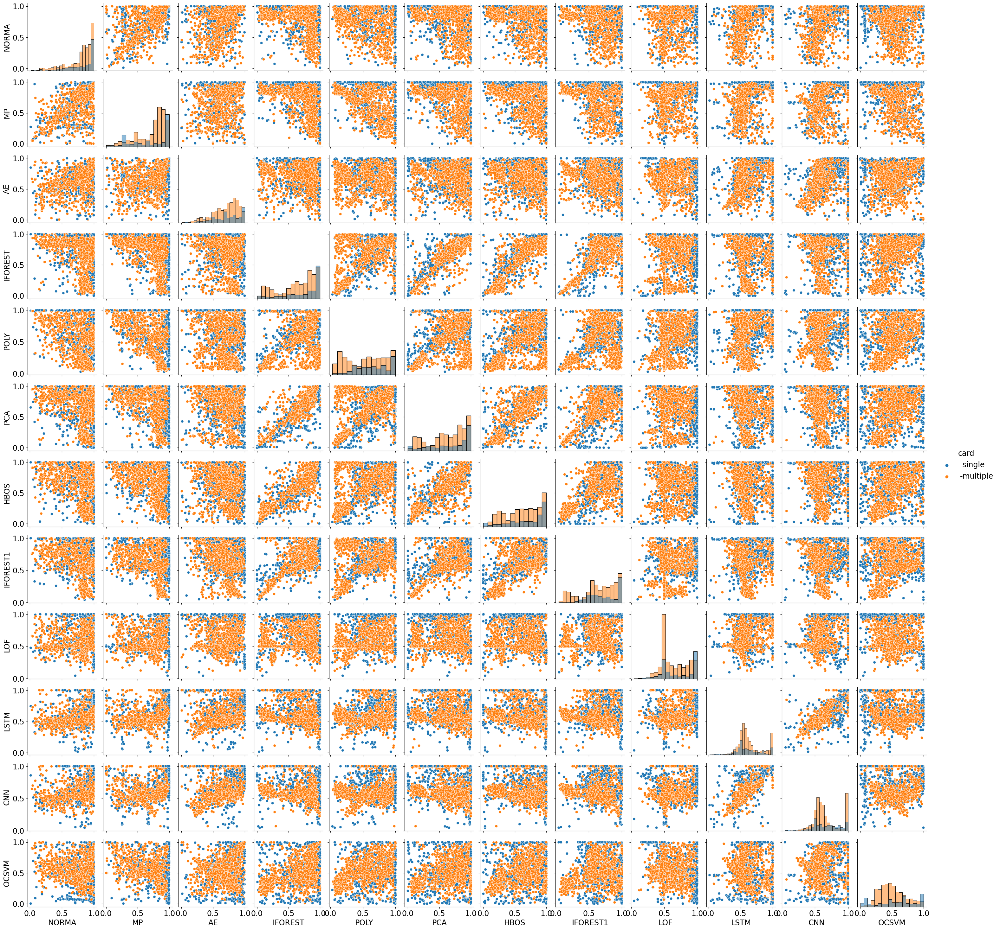

In [19]:
df_acc['card'] = pd.cut(df_acc['nb_anomaly'], bins=[0, 1, float('Inf')], labels=['-single', '-multiple'])
sns.pairplot(df_acc[methods_all + ['card']], hue="card",diag_kind='hist')

## III.4. Pairwise Comparisons of Methods: All categories

* __Mixed-multiple__: Time series containing both point and sequence anomalies
* __point-single__: Time seires containing only one point anomaly
* __point-multiple__: Time seires containing multiple point anomalies
* __sequence-single__: Time series containing one sequence anomaly
* __sequence-multiple__: Time series containing multiple sequence anomalies

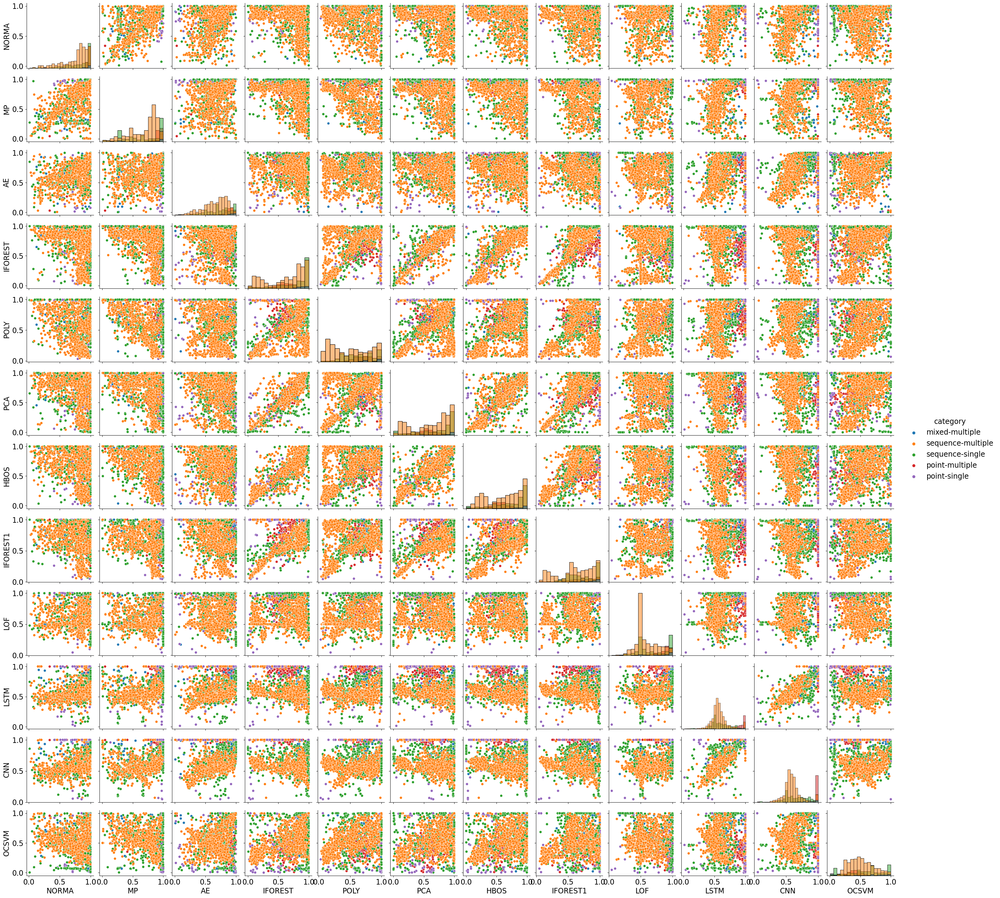

In [20]:
df_acc['category'] = df_acc.apply(lambda row: str(row.type_an) + str(row.card), axis=1)
sns.pairplot(df_acc[methods_all + ['category']], hue="category",diag_kind='hist')

## III.5. Influence of the anomaly length


Here we compare the accuracy versus the average anomaly length per time series. We compute the average anomaly length that in a given time series.
Each scatter point is one time series.

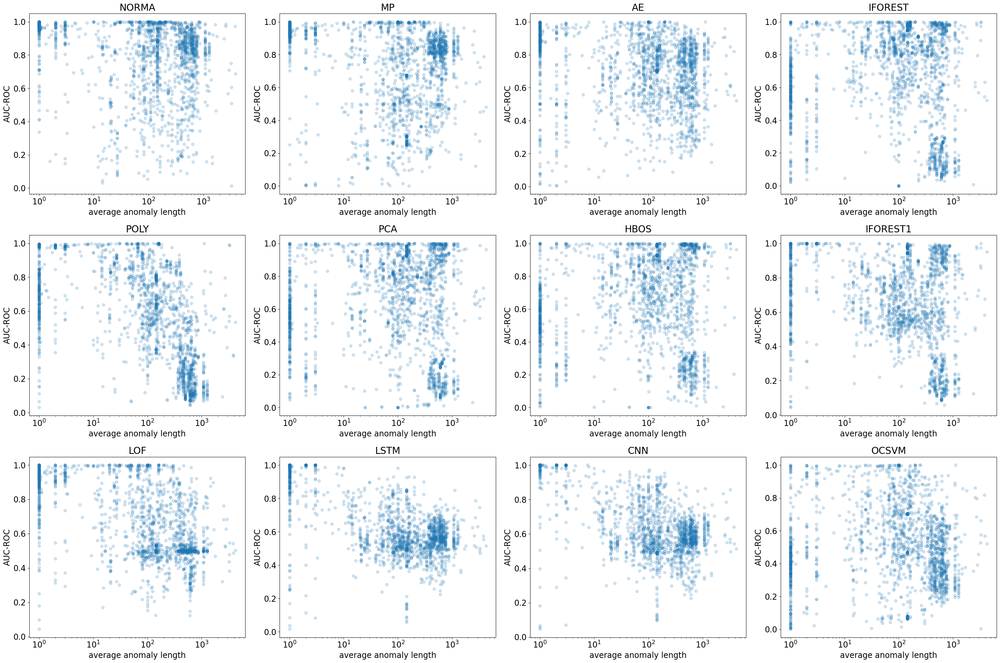

In [21]:
plt.figure(figsize=(30,20))
for i,method in enumerate(methods_all):
    plt.subplot(3,4,i+1)
    plt.title(method)
    plt.scatter(df_acc['average_anom_length'],df_acc[method],alpha=0.2)
    plt.xscale('log')
    plt.ylabel('AUC-ROC')
    plt.xlabel('average anomaly length')
plt.tight_layout()

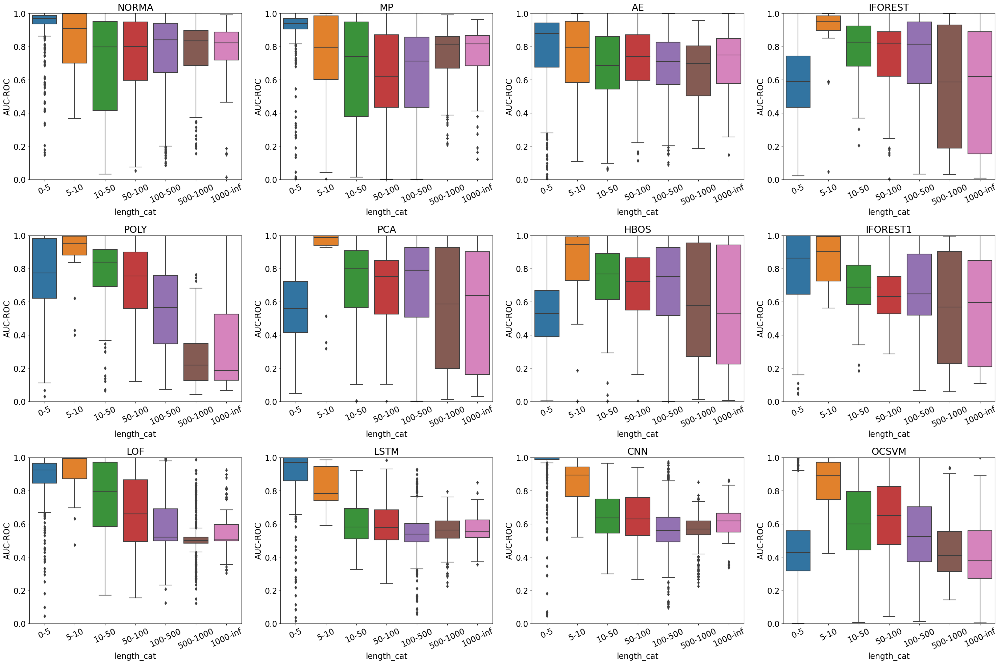

In [22]:
df_acc['length_cat'] = pd.cut(df_acc['average_anom_length'], bins=[0,5,10,50,100,500,1000, float('Inf')], labels=['0-5','5-10','10-50','50-100','100-500','500-1000','1000-inf'])
plt.figure(figsize=(30,20))
for i,method in enumerate(methods_all):
    plt.subplot(3,4,i+1)
    plt.title(method)
    sns.boxplot(x='length_cat',y=method,data=df_acc[[method,'length_cat']])
    plt.ylabel('AUC-ROC')
    plt.xticks(rotation=25)
    plt.ylim(0,1)
    
plt.tight_layout()

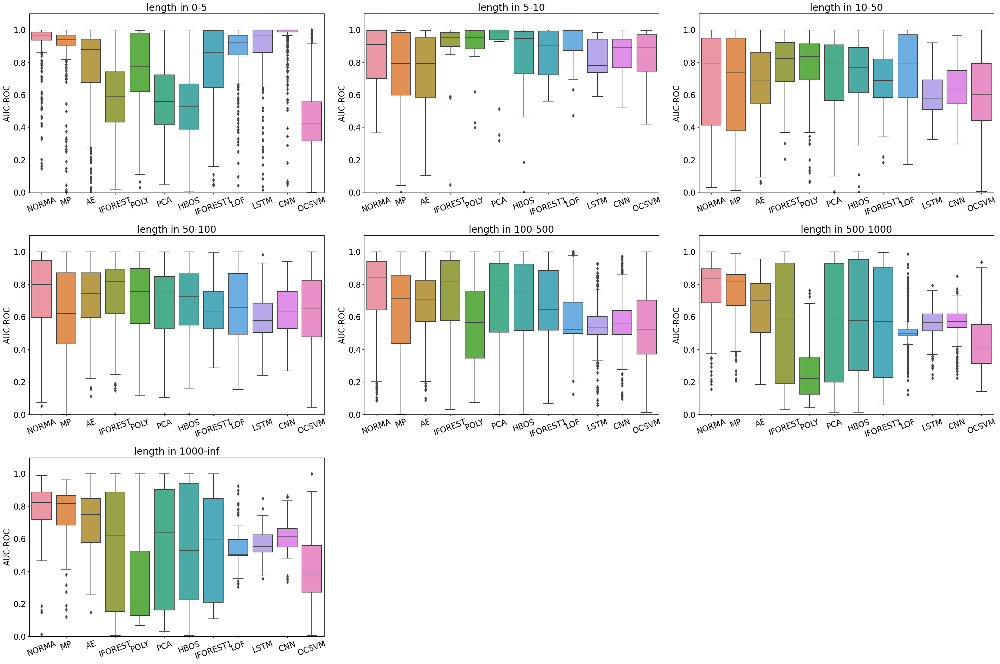

In [23]:
plt.figure(figsize=(30,20))
for i,cat in enumerate(['0-5','5-10','10-50','50-100','100-500','500-1000','1000-inf']):
    plt.subplot(3,3,i+1)
    plt.title('length in {}'.format(cat))
    sns.boxplot(data= df_acc[methods_all].loc[df_acc['length_cat'] == cat])
    plt.ylabel('AUC-ROC')
    plt.xticks(rotation=20)
    plt.ylim(0,1.1)
    
plt.tight_layout()

## III.5. Influence of the Normal/abnormal ratio

Here we compare the accuracy versus the normal abnormal ratio. We compute for each time series the atio between the number of normal and abnormal points.
Each scatter point is one time series.

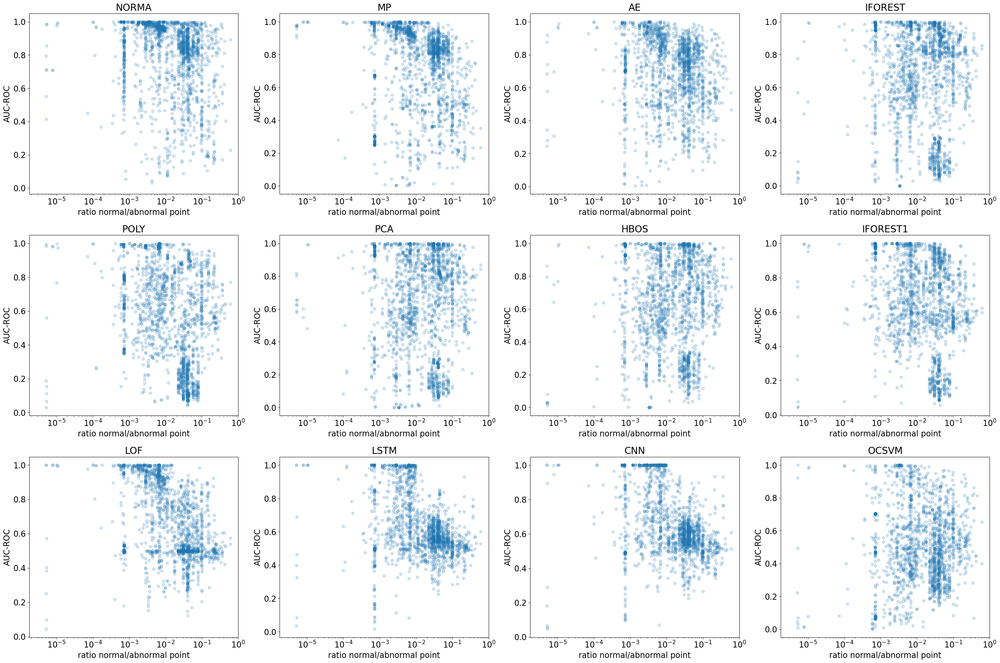

In [24]:
plt.figure(figsize=(30,20))
for i,method in enumerate(methods_all):
    plt.subplot(3,4,i+1)
    plt.title(method)
    plt.scatter(df_acc['ratio'],df_acc[method],alpha=0.2)
    plt.xscale('log')
    plt.ylabel('AUC-ROC')
    plt.xlabel('ratio normal/abnormal point')
    plt.xlim(0,1)
plt.tight_layout()

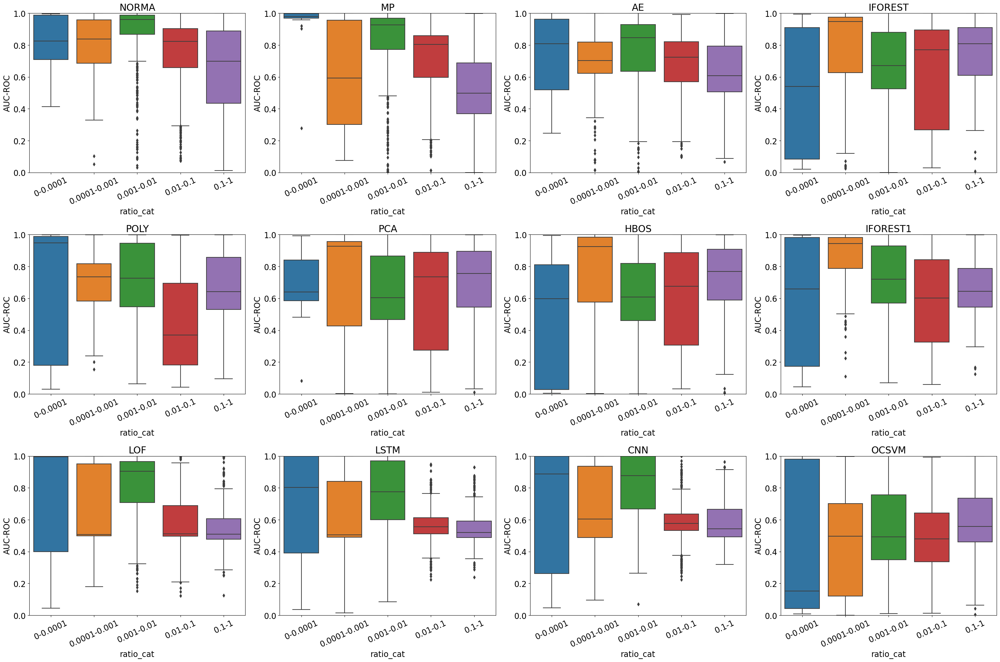

In [25]:
df_acc['ratio_cat'] = pd.cut(df_acc['ratio'], bins=[0,0.0001,0.001,0.01,0.1,float('Inf')], labels=['0-0.0001','0.0001-0.001','0.001-0.01','0.01-0.1','0.1-1'])
plt.figure(figsize=(30,20))
for i,method in enumerate(methods_all):
    plt.subplot(3,4,i+1)
    plt.title(method)
    sns.boxplot(x='ratio_cat',y=method,data=df_acc[[method,'ratio_cat']])
    plt.ylabel('AUC-ROC')
    plt.xticks(rotation=25)
    plt.ylim(0,1)
    
plt.tight_layout()

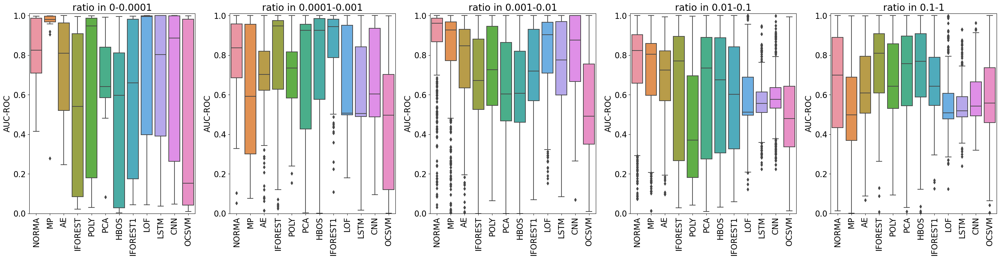

In [26]:
plt.figure(figsize=(30,8))
for i,cat in enumerate(['0-0.0001','0.0001-0.001','0.001-0.01','0.01-0.1','0.1-1']):
    plt.subplot(1,5,i+1)
    plt.title('ratio in {}'.format(cat))
    sns.boxplot(data= df_acc[methods_all].loc[df_acc['ratio_cat'] == cat])
    plt.ylabel('AUC-ROC')
    plt.xticks(rotation=90)
    plt.ylim(0,1.01)
    
plt.tight_layout()

## III.5. Global Accuracy Evaluation per Methods

Here we compute the overall accuracy box plot for each method over the entire benchmark.

Text(0.5, 1.0, 'AUC-ROC on the entire benchmark')

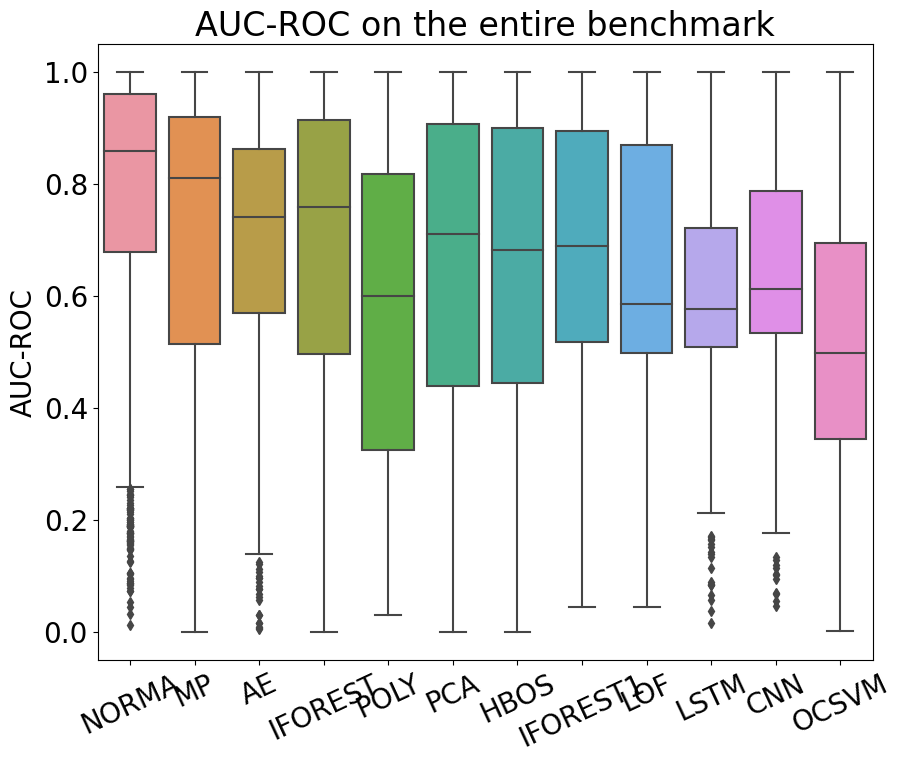

In [28]:
order_all = ['NORMA','MP','AE','IFOREST','POLY','PCA','HBOS','IFOREST1','LOF','LSTM','CNN','OCSVM']
    
def plt_style(df,rot=25):
    plt.xticks(rotation=rot)
    plt.ylabel('AUC-ROC')
plt.rcParams.update({'font.size': 20})
plt.figure(figsize=(10,8))
sns.boxplot(data=df_acc[order_all])
plt_style(df_acc[methods_all])
plt.title("AUC-ROC on the entire benchmark")

## III.6. Global Accuracy Evaluation per Methods: Point vs Sequence

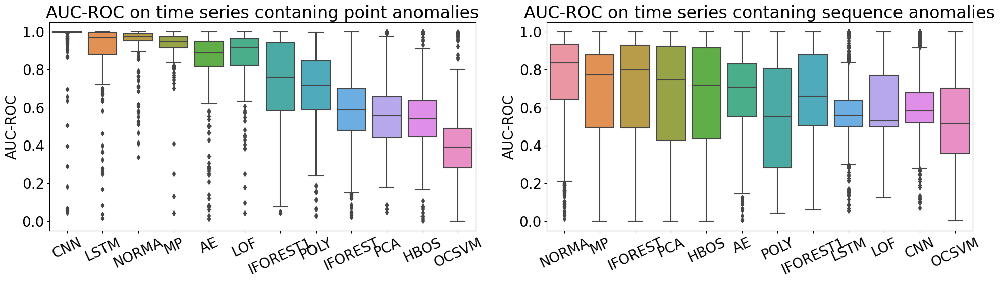

In [29]:
import seaborn as sns

order_point = ['CNN','LSTM','NORMA','MP','AE','LOF','IFOREST1','POLY','IFOREST','PCA','HBOS','OCSVM']
order_seq = ['NORMA','MP','IFOREST','PCA','HBOS','AE','POLY','IFOREST1','LSTM','LOF','CNN','OCSVM']


plt.rcParams.update({'font.size': 20})
plt.figure(figsize=(20,6))
plt.subplot(1,2,1)
sns.boxplot(data=df_acc[df_acc['point_anom'] == 1][order_point])
plt_style(df_acc[df_acc['point_anom'] == 1][methods_all])
plt.title("AUC-ROC on time series contaning point anomalies")
plt.subplot(1,2,2)
sns.boxplot(data=df_acc[df_acc['seq_anom'] == 1][order_seq])
plt_style(df_acc[df_acc['seq_anom'] == 1][methods_all])
plt.title("AUC-ROC on time series contaning sequence anomalies")
plt.tight_layout()


## III.7. Global Accuracy Evaluation per Methods: single vs multiple

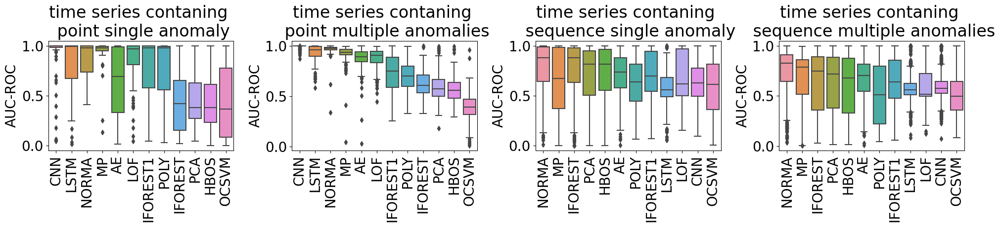

In [30]:
plt.figure(figsize=(20,5))
plt.subplot(1,4,1)
sns.boxplot(data=df_acc[df_acc['point_anom'] == 1][df_acc['nb_anomaly'] == 1][order_point])
plt_style(df_acc[df_acc['point_anom'] == 1][df_acc['nb_anomaly'] == 1][order_point],rot=90)
plt.title("time series contaning \n point single anomaly")
plt.subplot(1,4,2)
sns.boxplot(data=df_acc[df_acc['point_anom'] == 1][df_acc['nb_anomaly'] > 1][order_point])
plt_style(df_acc[df_acc['point_anom'] == 1][df_acc['nb_anomaly'] > 1][order_point],rot=90)
plt.title("time series contaning \n point multiple anomalies")
plt.subplot(1,4,3)
sns.boxplot(data=df_acc[df_acc['seq_anom'] == 1][df_acc['nb_anomaly'] == 1][order_seq])
plt_style(df_acc[df_acc['seq_anom'] == 1][df_acc['nb_anomaly'] == 1][order_seq],rot=90)
plt.title("time series contaning \n sequence single anomaly")
plt.subplot(1,4,4)
sns.boxplot(data=df_acc[df_acc['seq_anom'] == 1][df_acc['nb_anomaly'] > 1][order_seq])
plt_style(df_acc[df_acc['seq_anom'] == 1][df_acc['nb_anomaly'] > 1][order_seq],rot=90)
plt.title("time series contaning \n sequence multiple anomalies")
plt.tight_layout()